In [1]:
import sys
import typing as tp
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np

sys.path.append('../')
from src.data.psf import get_psf
from src.data.convolution import convolve
from src.data.utils import read_image
from src.deconv.classic.wiener import wiener_rgb, wiener_gray

plt.gray()

<Figure size 640x480 with 0 Axes>

In [2]:
def get_psfs(
    s_range: np.array,
    c_range: np.array,
    a: float | int,
    s_fixed: float,
    c_fixed: float,
    num_psfs: int,
    pupil_diam: float = 4,
    view_dist: float = 100, 
    canvas_size_h: float = 10,
) -> tp.Tuple[dict, dict]:
    """Get PSFs in correct forn=mat for `viz_robustness()`"""
    
    psfs = {}
    for i in range(num_psfs):
        psfs[i] = {
            'psf': get_psf(s=s_range[i], a=a, c=c_range[i], pupil_diam=pupil_diam, view_dist=view_dist, canvas_size_h=canvas_size_h),
            'params': {
                'S': s_range[i],
                'A': a,
                'C': c_range[i],
            }
        }

        psf_fixed = {
            'psf': get_psf(s=s_fixed, a=a, c=c_fixed, pupil_diam=pupil_diam, view_dist=view_dist, canvas_size_h=canvas_size_h),
            'params': {
                'S': s_fixed,
                'A': a,
                'C': c_fixed,
            }
        }
    return psfs, psf_fixed


def get_param_string(param_dict: dict) -> str:
    param_string = ' '
    for key, value in param_dict.items():
        param_string += f'{key}: {round(value, 3)} '
    return param_string


def viz_robustness(
    image: np.array,
    psfs: dict,
    psf_fixed: dict,
    deconv_algo: tp.Callable,
    noise: tp.Optional[np.array] = None,
    **algo_params,
):
    """Vizulize robustness of an algorithm.

    Parameters
    ----------
    image : np.array
        Sharp image
    psfs : dict
        Dictionary with psfs (np.array) and their params (dict)
    psf_fixed : np.array
        Dictionary with the fixed PSF (assumed to be the `true' PSF) from which the blurred image is convolved and its params.
    deconv_algo : tp.Callable
        Deconvolution algorithm.
    """
    num_psfs = len(psfs)
    fig, axs = plt.subplots(8, num_psfs, figsize=(5 * num_psfs, 5 * 8))

    for i in range(num_psfs):
        psf_correct = psfs[i]['psf']
        psf_correct_params = psfs[i]['params']

        psf_incorrect = psf_fixed['psf']
        psf_incorrect_params = psf_fixed['params']

        blurred_image = convolve(image, psf_correct)
        blurred_noised_image = blurred_image + noise

        restored_image_correct = wiener_rgb(blurred_image, psf_correct, balance=100)
        restored_image_incorrect = wiener_rgb(blurred_image, psf_incorrect, balance=100)

        restored_noised_image_correct = wiener_rgb(blurred_noised_image, psf_correct, balance=100)
        restored_noised_image_incorrect = wiener_rgb(blurred_noised_image, psf_incorrect, balance=100)

        axs[0, i].imshow(blurred_image / 255.)
        axs[0, i].axis('off')
        axs[0, i].set_title('Blurred image (w/ correct PSF)')

        axs[1, i].imshow(np.clip(blurred_noised_image / 255., 0, 1))
        axs[1, i].axis('off')
        axs[1, i].set_title('Blurred noised image (w/ correct PSF)')

        axs[2, i].imshow(psf_correct)
        axs[2, i].axis('off')
        axs[2, i].set_title(f'Correct PSF | ' + get_param_string(psf_correct_params))

        axs[3, i].imshow(np.clip(restored_image_correct, 0, 1))
        axs[3, i].axis('off')
        axs[3, i].set_title('Restored image (w/ correct PSF)')

        axs[4, i].imshow(np.clip(restored_noised_image_correct, 0, 1))
        axs[4, i].axis('off')
        axs[4, i].set_title('Restored noised (w/ correct PSF)')

        axs[5, i].imshow(psf_incorrect)
        axs[5, i].axis('off')
        axs[5, i].set_title(f'Incorrect PSF | ' + get_param_string(psf_incorrect_params))

        axs[6, i].imshow(np.clip(restored_image_incorrect, 0, 1))
        axs[6, i].axis('off')
        axs[6, i].set_title('Restored image (w/ incorrect PSF)')

        axs[7, i].imshow(np.clip(restored_noised_image_incorrect, 0, 1))
        axs[7, i].axis('off')
        axs[7, i].set_title('Restored noised image (w/ incorrect PSF)')

# Restoration

In [3]:
icons = list(Path('/home/chaganovaob/edu/deconvolution-benchmark/data/icons_jpg').rglob('*.png'))
faces = list(Path('/home/chaganovaob/edu/deconvolution-benchmark/data/images/faces').rglob('*.jpg'))
animals = list(Path('/home/chaganovaob/edu/deconvolution-benchmark/data/images/animals').rglob('*.jpg'))

image = read_image(str(icons[0]))
image_face = read_image(str(faces[0]))
image_animal = read_image(str(animals[1]))

noise = np.random.normal(loc=0, scale=0.1, size=image.shape)
noise.min(), noise.mean(), noise.max()

(-0.48107014442537815, 0.00010124931093283924, 0.4661943720756492)

## 1 Small PSFs

Проверка робастности алгоритма к ошибкам в оценке PSF:
1. Изображение размывается с PSF correct;

2. На вход алгоритму подается изображение (1) и PSF incorrect (численные значения параметров отлтичаются от PSF correct; форма ядра остается та же)

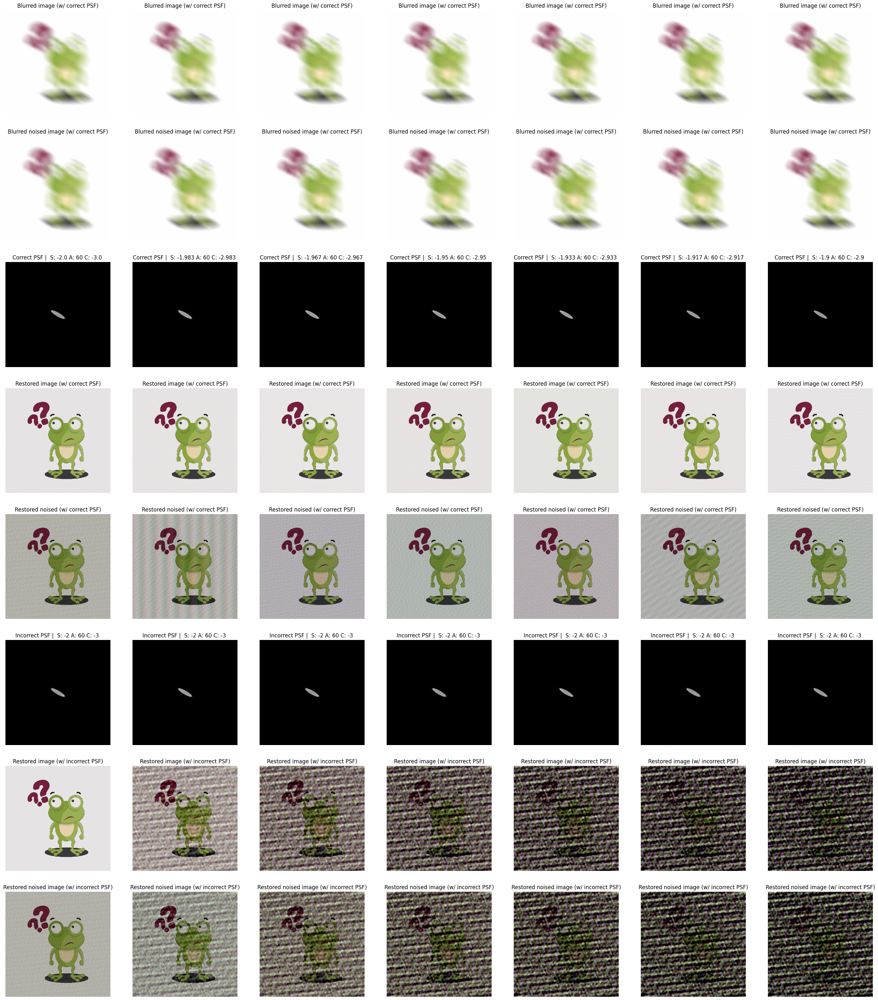

In [4]:
num_psfs = 7

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-2, -1.9, num_psfs),
    a=60,
    c_range=np.linspace(-3, -2.9, num_psfs),
    s_fixed=-2,
    c_fixed=-3,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, balance=1100)

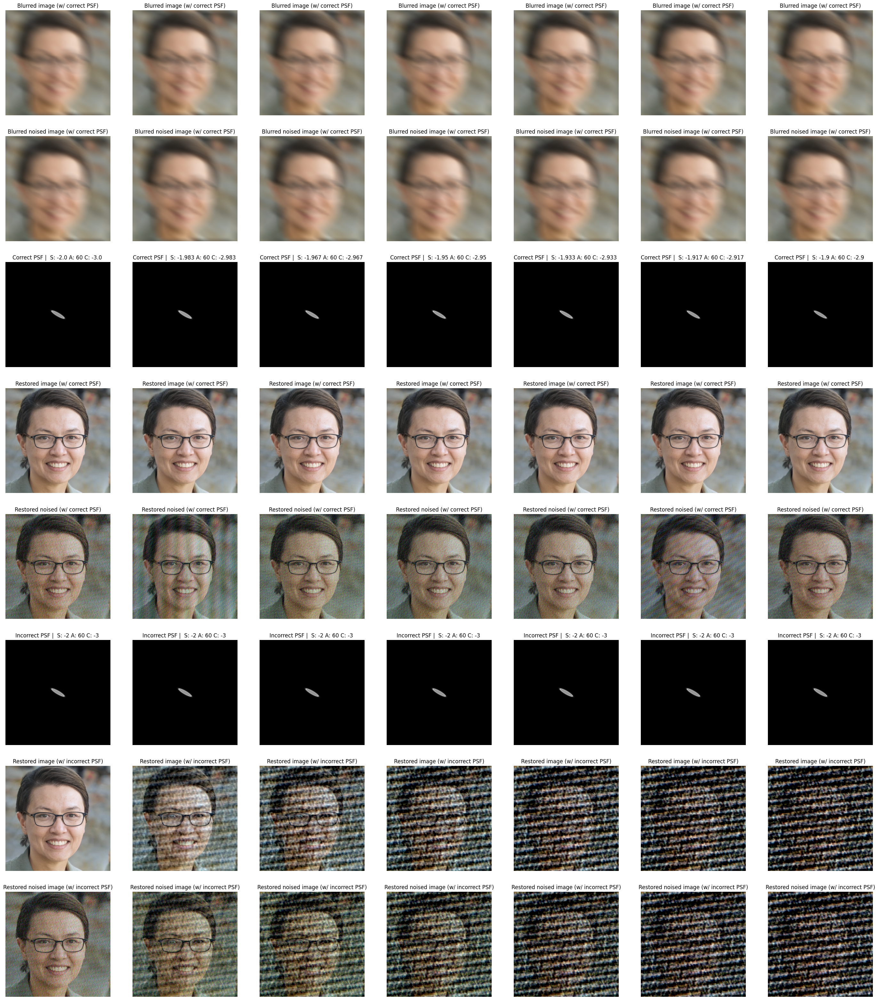

In [5]:
num_psfs = 7

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-2, -1.9, num_psfs),
    a=60,
    c_range=np.linspace(-3, -2.9, num_psfs),
    s_fixed=-2,
    c_fixed=-3,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

viz_robustness(image_face, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, balance=1100)

## 2 Big PSFs

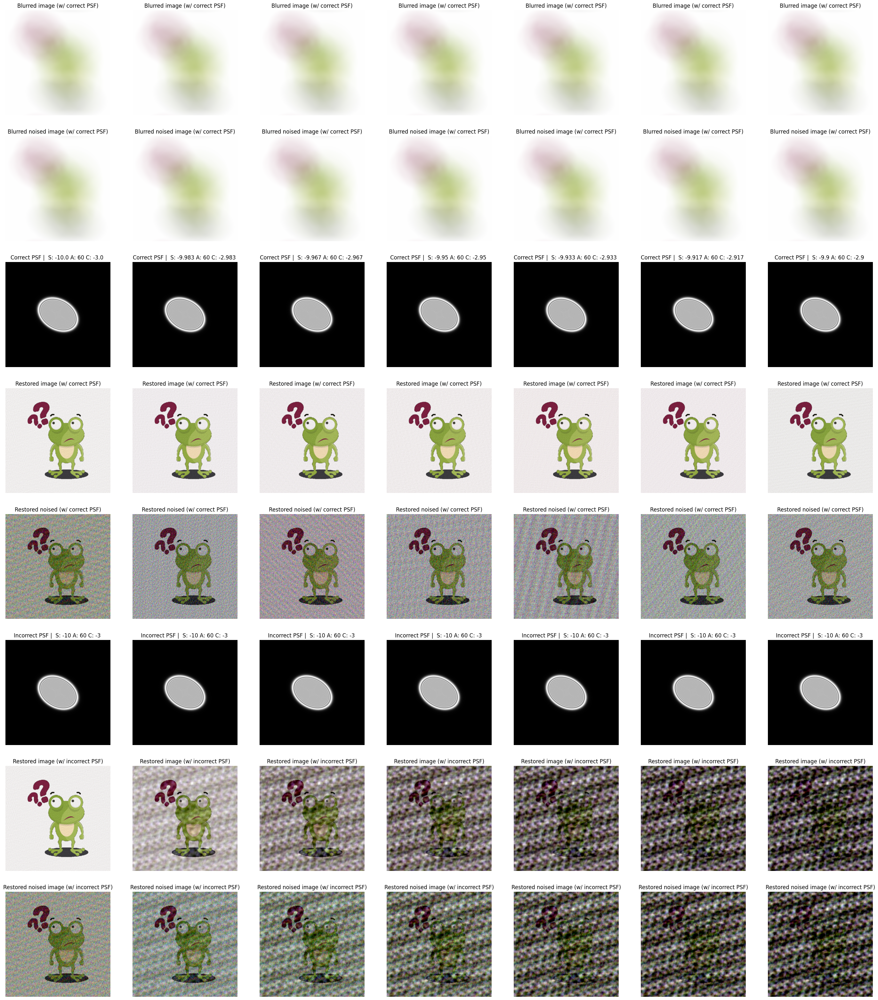

In [6]:
num_psfs = 7

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-10, -9.9, num_psfs),
    a=60,
    c_range=np.linspace(-3, -2.9, num_psfs),
    s_fixed=-10,
    c_fixed=-3,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, balance=1100)

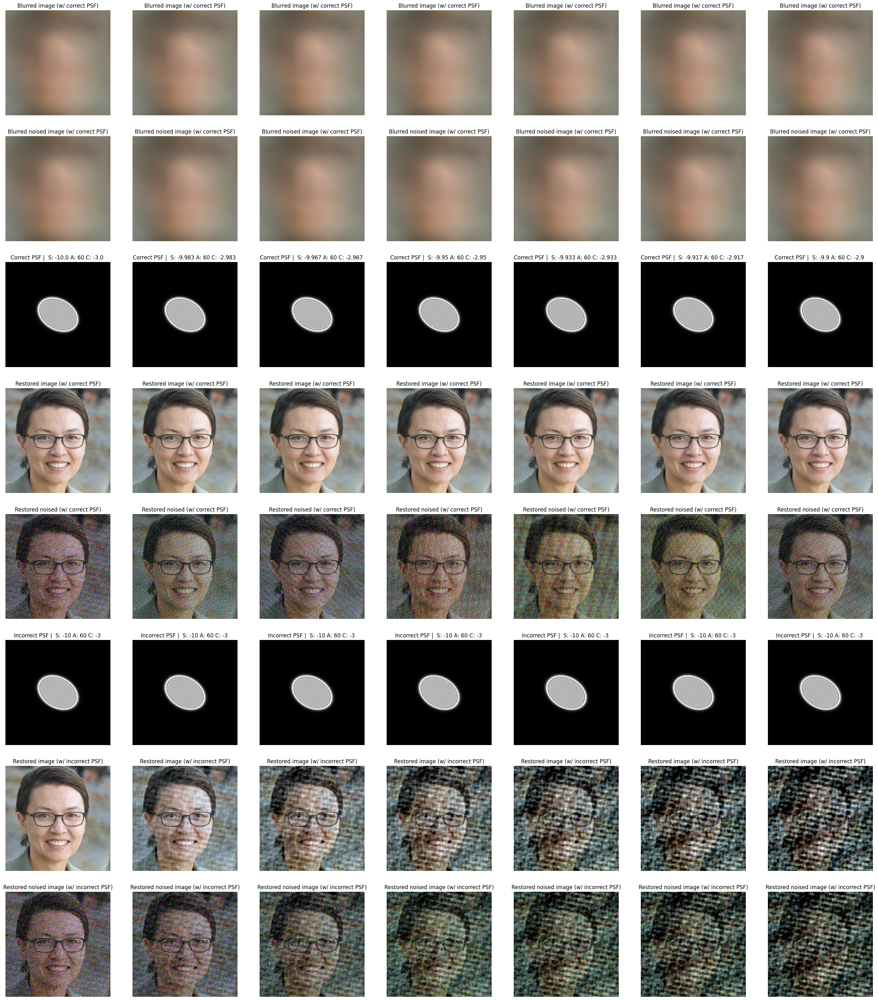

In [7]:
num_psfs = 7

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-10, -9.9, num_psfs),
    a=60,
    c_range=np.linspace(-3, -2.9, num_psfs),
    s_fixed=-10,
    c_fixed=-3,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

viz_robustness(image_face, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, balance=1100)

## 3 Different sizes

In [4]:
noise = np.random.normal(loc=0, scale=0.1, size=image_animal.shape)
noise.min(), noise.mean(), noise.max()

(-0.48140601418697754, -5.590921809534772e-05, 0.475466913132719)

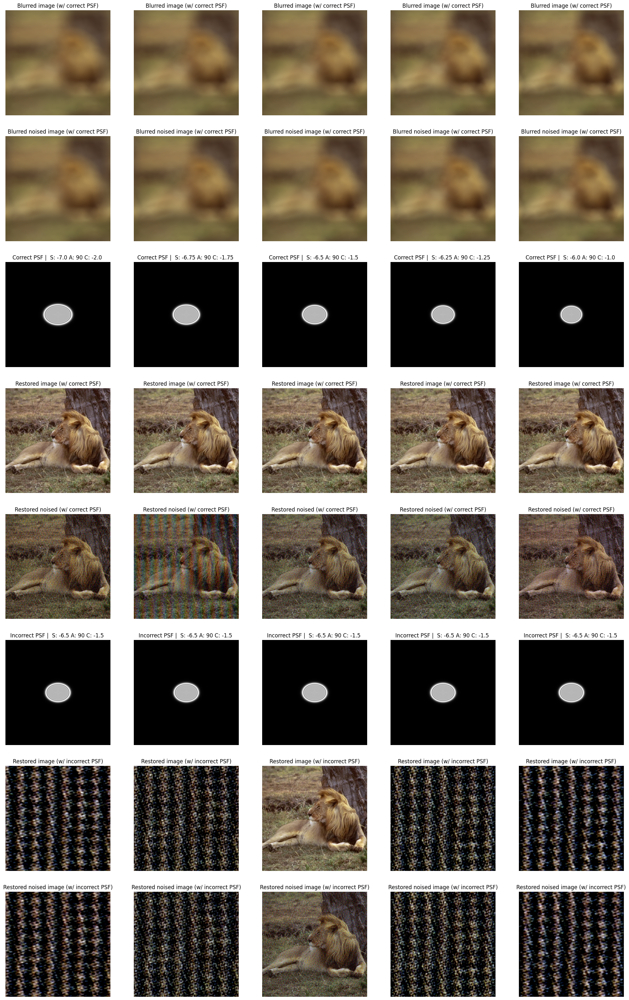

In [9]:
num_psfs = 5

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-7, -6, num_psfs),
    a=90,
    c_range=np.linspace(-2, -1, num_psfs),
    s_fixed=-6.5,
    c_fixed=-1.5,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

viz_robustness(image_animal, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, balance=1100)